# ERM-EB316 (aluminium silicon alloy AlSi12)

This notebook contains the results for the dataset ERM-EB316:

### Chapters:
 - Baseline Regression
 - Baseline Simulation

#### Source Directory

In [1]:
sdir = r'..\data\raw data txt\ERM-EB316'

#### Imports

In [2]:
import os, sys
if os.path.dirname(os.getcwd()) not in sys.path:
    sys.path.insert(0, os.path.dirname(os.getcwd())) # appends parent directory to syspath -> enables import of src

import lib.datalayers as dly
import lib.model as mod
import importlib
importlib.reload(mod)
importlib.reload(dly)

<module 'lib.datalayers' from 'c:\\Users\\Marlene\\Nextcloud\\DOKUMENTE\\Universität\\Diplomarbeit\\lib\\datalayers.py'>

#### Initialize dataset

In [3]:
dataset = dly.Dataset(sdir,overwrite=False)

Dataset: ERM-EB316
Files of dataset loaded


## Baseline Regression

The best settings for baseline regression were:
- minima filter width = 40 nm
- detailed region for minima filter at start and end of spectrum = 20
- steps of minima filter within detailed region = 40/2/10
- minima filter in both directions = False
- endpoint weight = 10000

The common degree was 4.

It was not possible to figure out the best baseline settings by visual analysation of the baseline, since the baselines do not change significantly with the change of a parameter. However, at baseline simulation, it was noticed, that the baseline settings do have an influence on to the simulated baseline. Thatswhy the simulated baseline is taken into account as well to find the optimal settings for baseline regression.

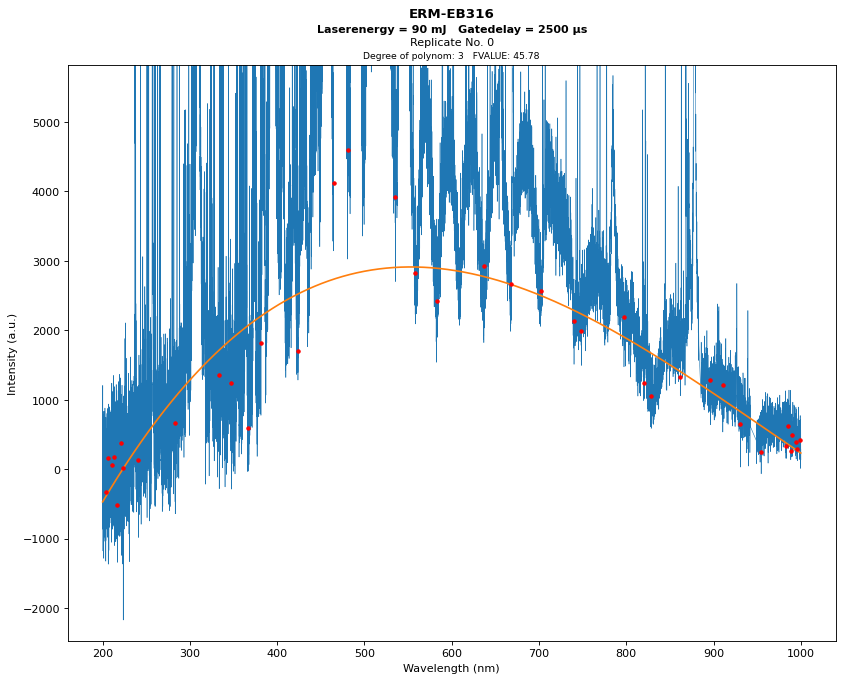

In [5]:
spectrum = dly.Spectrum(dataset, laser_energy=90, gate_delay=2500, DEBUG=False, repno=0)
spectrum.cond.interpolate_dead_pixels()
spectrum.baseline.find_pivot_points(width_wvn_detail=20, detailfactor=10, reverse=False)
spectrum.baseline.calculate_regression(endpoint_weight=1, deg_min=3)
spectrum.plot_spectrum(view="detail", dpi=80)

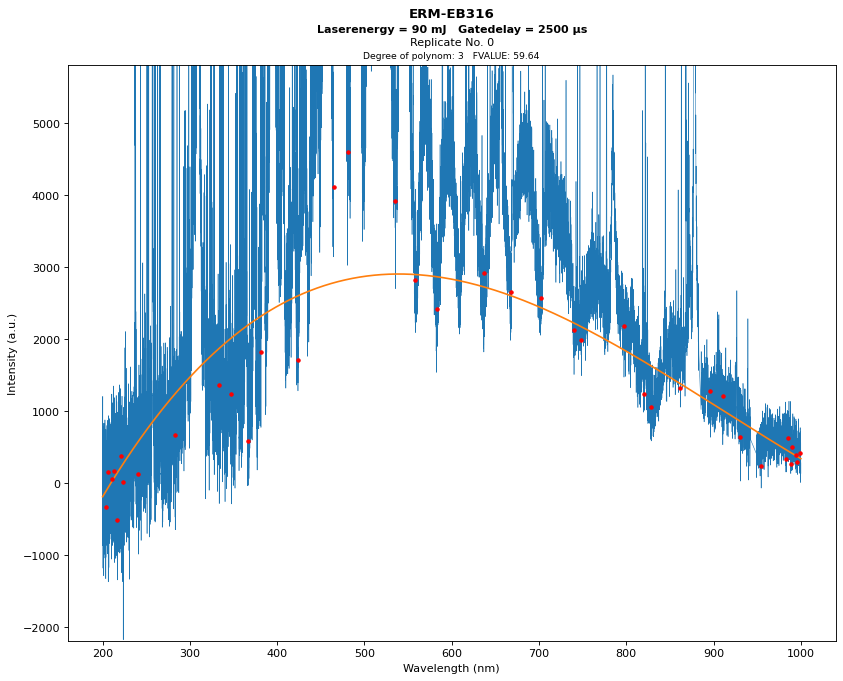

In [6]:
spectrum = dly.Spectrum(dataset, laser_energy=90, gate_delay=2500, DEBUG=False, repno=0)
spectrum.cond.interpolate_dead_pixels()
spectrum.baseline.find_pivot_points(width_wvn_detail=20, detailfactor=10, reverse=False)
spectrum.baseline.calculate_regression(endpoint_weight=10000, deg_min=3)
spectrum.plot_spectrum(view="detail", dpi=80)

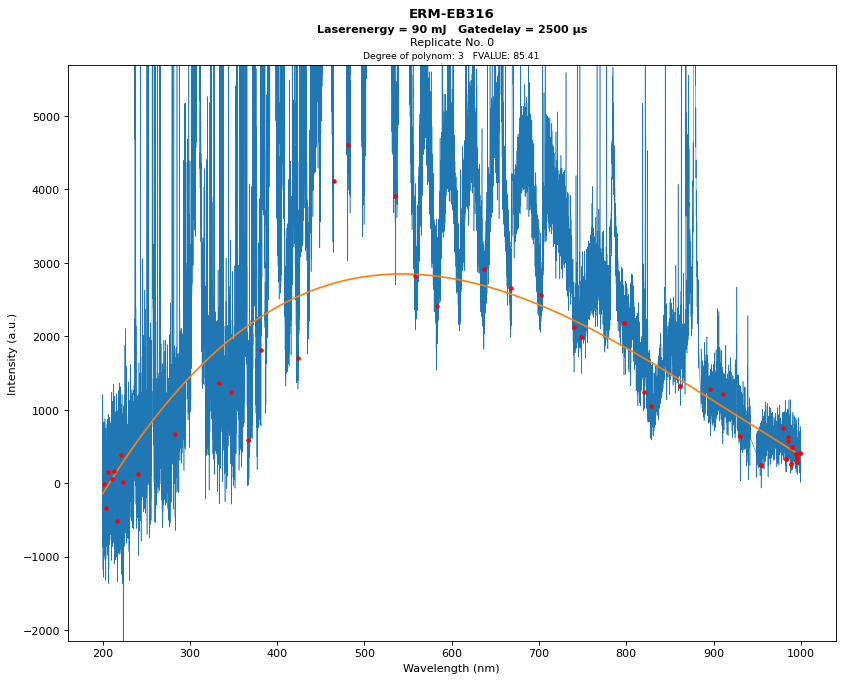

In [7]:
spectrum = dly.Spectrum(dataset, laser_energy=90, gate_delay=2500, DEBUG=False, repno=0)
spectrum.cond.interpolate_dead_pixels()
spectrum.baseline.find_pivot_points(width_wvn_detail=20, detailfactor=10, reverse=True)
spectrum.baseline.calculate_regression(endpoint_weight=10000, deg_min=3)
spectrum.plot_spectrum(view="detail", dpi=80)

Taking the simulated spectra into consideration as well revealed the influence of baseline settings.

Fit model: 100%|██████████| 4/4 [00:00<00:00, 14.46it/s]


Condition: Laser energy: 90 mJ | Gate delay: 2500 µs


LE=90 mJ | GD=2500 µs | Calculate baseline for each spectrum: 100%|██████████| 100/100 [00:02<00:00, 43.17it/s]


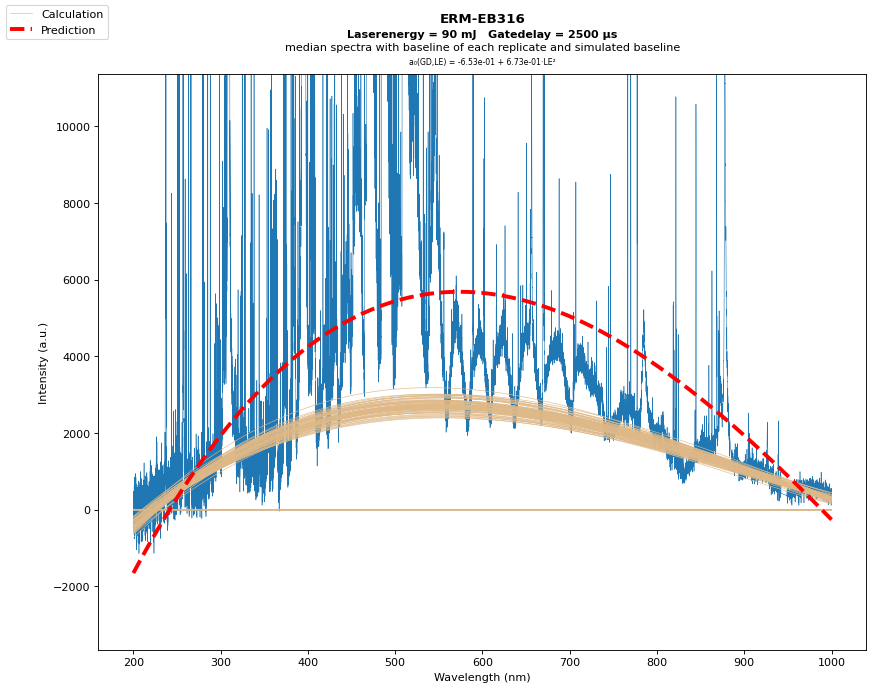

In [8]:
summary_baseline_coeff_regression, baseline_regression_settings = dataset.summarize_baseline_coefficients(deg_min=3, deg_max=3, width_wvn_detail=20, detailfactor=10, reverse=False, endpoint_weight=1, overwrite=False)
baseline = mod.Baseline(dataset.name, summary_baseline_coeff_regression, baseline_regression_settings, median=True)
baseline_model = baseline.model.fit(transform_x=True, transform_y=True)
cond = dly.Condition(dataset, laser_energy=90, gate_delay=2500)
cond.interpolate_dead_pixels()
_,_,_,_ = cond.plot_cond(type_="stability", view="detail", baseline_model=baseline_model, deg_min=3, deg_max=3, width_wvn_detail=20, detailfactor=10, reverse=False, endpoint_weight=1, dpi=80)

Fit model: 100%|██████████| 4/4 [00:00<00:00, 14.13it/s]


Condition: Laser energy: 90 mJ | Gate delay: 2500 µs


LE=90 mJ | GD=2500 µs | Calculate baseline for each spectrum: 100%|██████████| 100/100 [00:01<00:00, 52.13it/s]


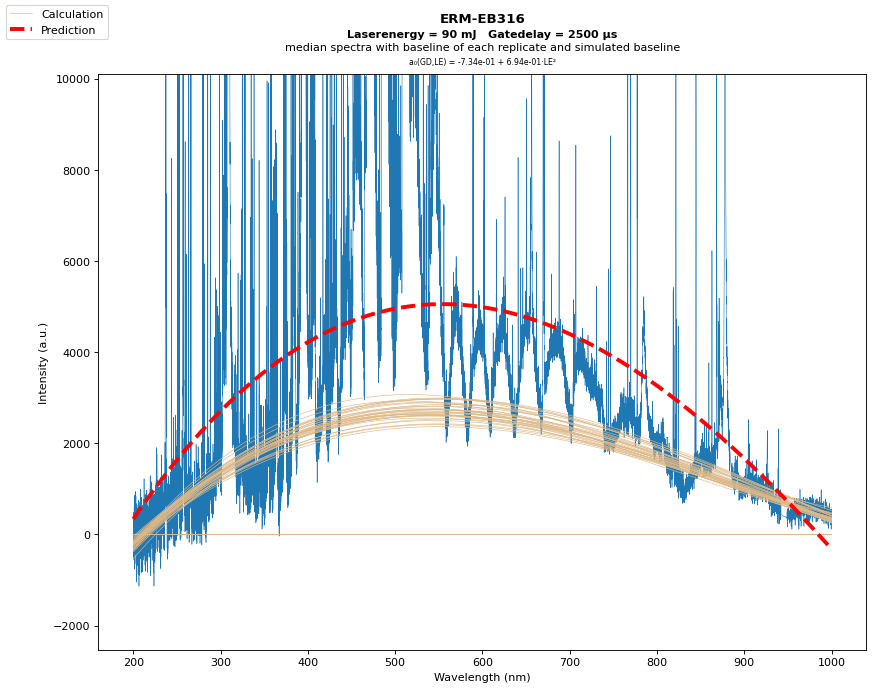

In [11]:
summary_baseline_coeff_regression, baseline_regression_settings = dataset.summarize_baseline_coefficients(deg_min=3, deg_max=3, width_wvn_detail=20, detailfactor=10, reverse=False, endpoint_weight=10000, overwrite=False)
baseline = mod.Baseline(dataset.name, summary_baseline_coeff_regression, baseline_regression_settings, median=True)
baseline_model = baseline.model.fit(transform_x=True, transform_y=True)
cond = dly.Condition(dataset, laser_energy=90, gate_delay=2500)
cond.interpolate_dead_pixels()
_,_,_,_ = cond.plot_cond(type_="stability", view="detail", baseline_model=baseline_model, deg_min=3, deg_max=3, width_wvn_detail=20, detailfactor=10, reverse=False, endpoint_weight=10000, dpi=80)

Fit model: 100%|██████████| 4/4 [00:00<00:00, 24.13it/s]


Condition: Laser energy: 90 mJ | Gate delay: 2500 µs


LE=90 mJ | GD=2500 µs | Calculate baseline for each spectrum: 100%|██████████| 100/100 [00:02<00:00, 37.88it/s]


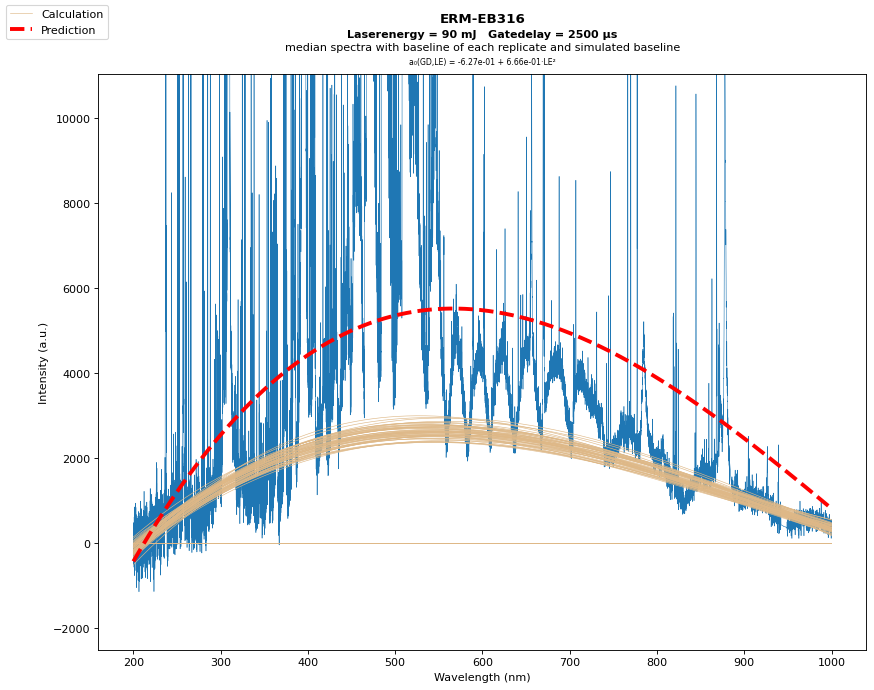

In [12]:
summary_baseline_coeff_regression, baseline_regression_settings = dataset.summarize_baseline_coefficients(deg_min=3, deg_max=3, width_wvn_detail=20, detailfactor=10, reverse=True, endpoint_weight=10000, overwrite=False)
baseline = mod.Baseline(dataset.name, summary_baseline_coeff_regression, baseline_regression_settings, median=True)
baseline_model = baseline.model.fit(transform_x=True, transform_y=True)
cond = dly.Condition(dataset, laser_energy=90, gate_delay=2500)
cond.interpolate_dead_pixels()
_,_,_,_ = cond.plot_cond(type_="stability", view="detail", baseline_model=baseline_model, deg_min=3, deg_max=3, width_wvn_detail=20, detailfactor=10, reverse=True, endpoint_weight=10000, dpi=80)

Due to major differences of simulated and the calculated baselines, it was presumed, that 4th degree polynomial might also be a good fit for the spectrum and could improve the simulation. Therefore, the best condition for polynomials of degree 4 were identified as well.

Fit model: 100%|██████████| 5/5 [00:00<00:00, 18.02it/s]


Condition: Laser energy: 90 mJ | Gate delay: 2500 µs


LE=90 mJ | GD=2500 µs | Calculate baseline for each spectrum: 100%|██████████| 100/100 [00:02<00:00, 38.42it/s]


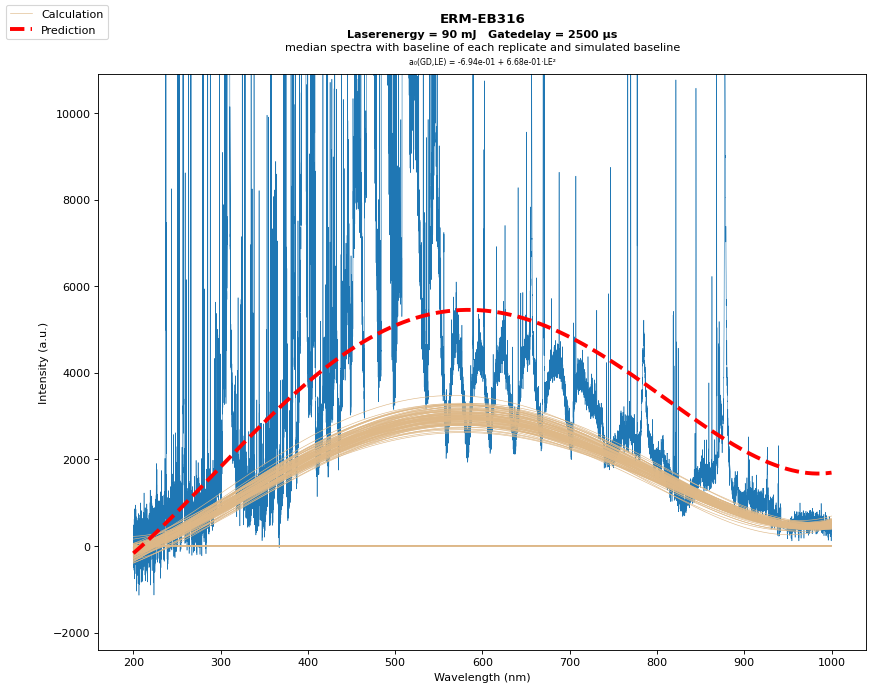

In [13]:
summary_baseline_coeff_regression, baseline_regression_settings = dataset.summarize_baseline_coefficients(deg_min=4, deg_max=4, width_wvn_detail=20, detailfactor=10, reverse=False, endpoint_weight=1, overwrite=False)
baseline = mod.Baseline(dataset.name, summary_baseline_coeff_regression, baseline_regression_settings, median=True)
baseline_model = baseline.model.fit(transform_x=True, transform_y=True)
cond = dly.Condition(dataset, laser_energy=90, gate_delay=2500)
cond.interpolate_dead_pixels()
_,_,_,_ = cond.plot_cond(type_="stability", view="detail", baseline_model=baseline_model, deg_min=4, deg_max=4, width_wvn_detail=20, detailfactor=10, reverse=False, endpoint_weight=1, dpi=80)

Fit model: 100%|██████████| 5/5 [00:00<00:00, 21.70it/s]


Condition: Laser energy: 90 mJ | Gate delay: 2500 µs


LE=90 mJ | GD=2500 µs | Calculate baseline for each spectrum: 100%|██████████| 100/100 [00:01<00:00, 59.39it/s]


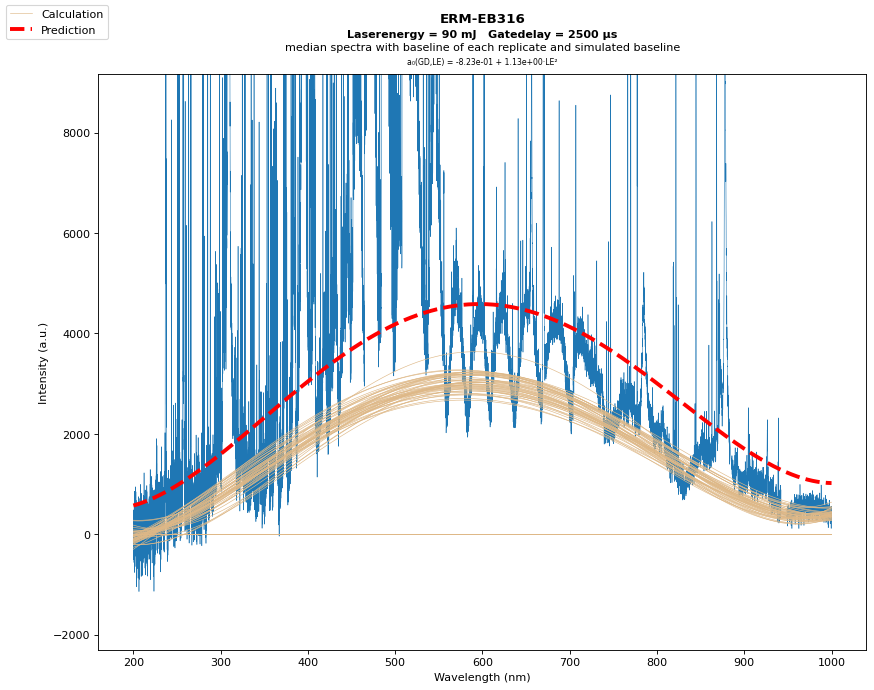

In [14]:
summary_baseline_coeff_regression, baseline_regression_settings = dataset.summarize_baseline_coefficients(deg_min=4, deg_max=4, width_wvn_detail=20, detailfactor=10, reverse=False, endpoint_weight=10000, overwrite=False)
baseline = mod.Baseline(dataset.name, summary_baseline_coeff_regression, baseline_regression_settings, median=True)
baseline_model = baseline.model.fit(transform_x=True, transform_y=True)
cond = dly.Condition(dataset, laser_energy=90, gate_delay=2500)
cond.interpolate_dead_pixels()
_,_,_,_ = cond.plot_cond(type_="stability", view="detail", baseline_model=baseline_model, deg_min=4, deg_max=4, width_wvn_detail=20, detailfactor=10, reverse=False, endpoint_weight=10000, dpi=80)

Fit model: 100%|██████████| 5/5 [00:00<00:00, 19.75it/s]


Condition: Laser energy: 90 mJ | Gate delay: 2500 µs


LE=90 mJ | GD=2500 µs | Calculate baseline for each spectrum: 100%|██████████| 100/100 [00:02<00:00, 40.60it/s]


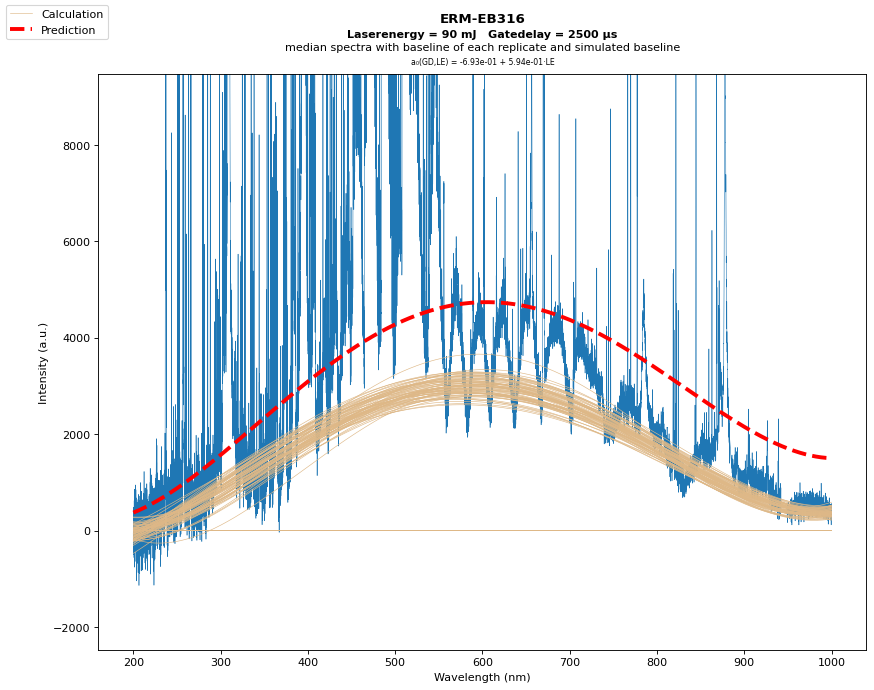

In [15]:
summary_baseline_coeff_regression, baseline_regression_settings = dataset.summarize_baseline_coefficients(deg_min=4, deg_max=4, width_wvn_detail=20, detailfactor=10, reverse=True, endpoint_weight=10000, overwrite=False)
baseline = mod.Baseline(dataset.name, summary_baseline_coeff_regression, baseline_regression_settings, median=True)
baseline_model = baseline.model.fit(transform_x=True, transform_y=True)
cond = dly.Condition(dataset, laser_energy=90, gate_delay=2500)
cond.interpolate_dead_pixels()
_,_,_,_ = cond.plot_cond(type_="stability", view="detail", baseline_model=baseline_model, deg_min=4, deg_max=4, width_wvn_detail=20, detailfactor=10, reverse=True, endpoint_weight=10000, dpi=80)

Depending on the polynomial degree, two different optimal settings for baseline regression were identified: \
Degree 3:
- minima filter width = 40 nm
- detailed region for minima filter at start and end of spectrum = 20
- steps of minima filter within detailed region = 40/2/10
- minima filter in both directions = True
- endpoint weight = 10000

\
Degree 4:
- minima filter width = 40 nm
- detailed region for minima filter at start and end of spectrum = 20
- steps of minima filter within detailed region = 40/2/10
- minima filter in both directions = False
- endpoint weight = 10000

Furthermore, the observed differences for simulated and calulated 4th degree polynomial baselines with optimal settings were more consistend over the wavelength range than for 3rd degree polynomials.

Moreover, the median common degrees for the two identified, optimal baselines settings were calculated:

Calculate plot: 100%|██████████| 48/48 [06:31<00:00,  8.16s/it]


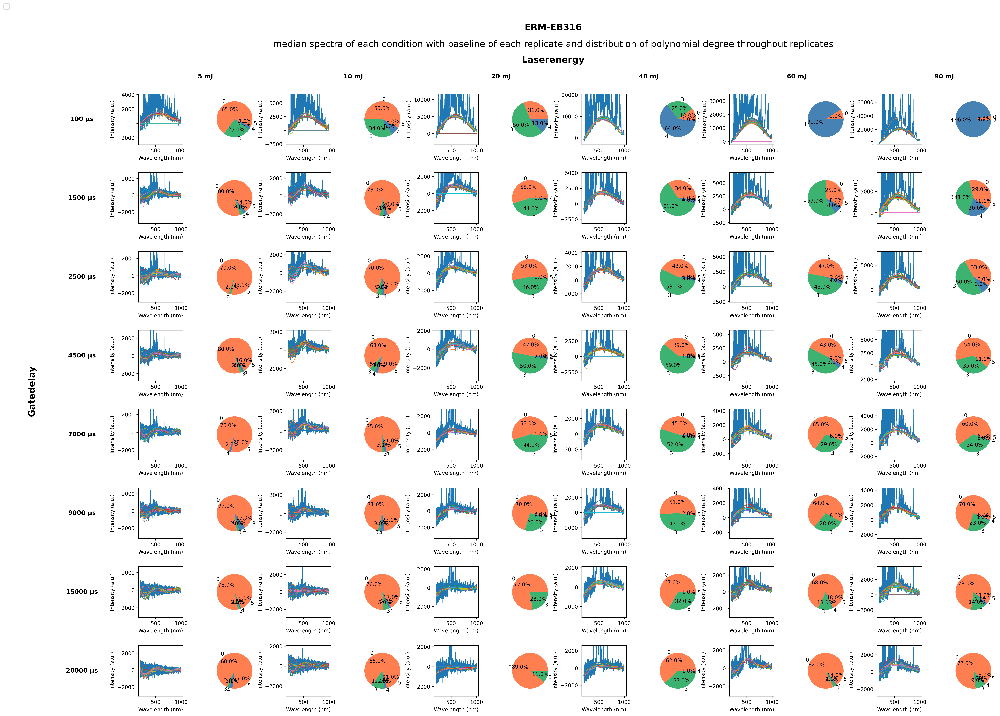

In [10]:
dataset.plot_dataset(type_list=["stability","pie"], deg_min=3, width_wvn_detail=20, detailfactor=10, reverse=True, endpoint_weight=10000)

In [20]:
import numpy as np
summary_baseline_coeff_regression, baseline_regression_settings =dataset.summarize_baseline_coefficients(deg_min=3, width_wvn_detail=20, detailfactor=10, reverse=True, endpoint_weight=10000, overwrite=False)
np.median(summary_baseline_coeff_regression["degree"])

Calculate summary_baseline_coeff:   0%|          | 0/48 [00:02<?, ?it/s]


0.0

Calculate plot: 100%|██████████| 48/48 [05:27<00:00,  6.82s/it]


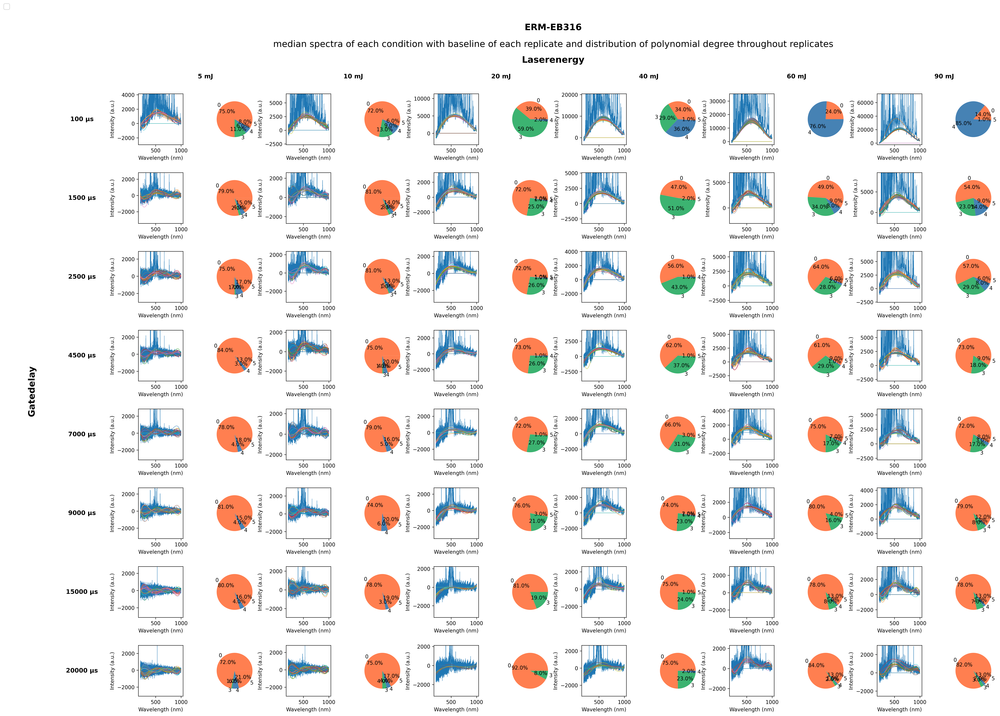

In [15]:
dataset.plot_dataset(type_list=["stability","pie"], deg_min=3, width_wvn_detail=20, detailfactor=10, reverse=False, endpoint_weight=10000)

In [19]:
import numpy as np
summary_baseline_coeff_regression, baseline_regression_settings =dataset.summarize_baseline_coefficients(deg_min=3, width_wvn_detail=20, detailfactor=10, reverse=False, endpoint_weight=10000, overwrite=False)
np.median(summary_baseline_coeff_regression["degree"])

Calculate summary_baseline_coeff:   0%|          | 0/48 [00:01<?, ?it/s]


0.0

Since it was not possible to decide between 3rd and 4th degree polynomials based on the median common degree, it was opted for 4th degree polynomials due to the more consistend offset of the simulated baseline compared to the caclulated baselines.

Calculate plot: 100%|██████████| 48/48 [06:18<00:00,  7.88s/it]


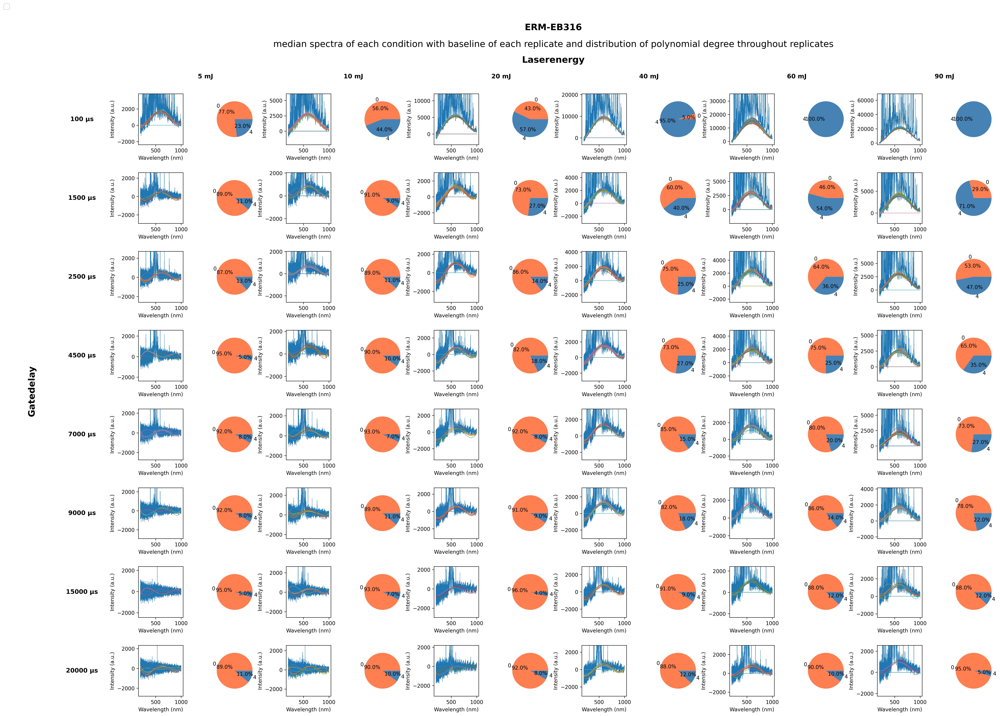

In [25]:
dataset.plot_dataset(type_list=["stability","pie"], deg_min=4, deg_max=4, width_wvn_detail=20, detailfactor=10, reverse=False, endpoint_weight=10000)

## Baseline Simulation

Fit model: 100%|██████████| 5/5 [00:00<00:00, 22.84it/s]


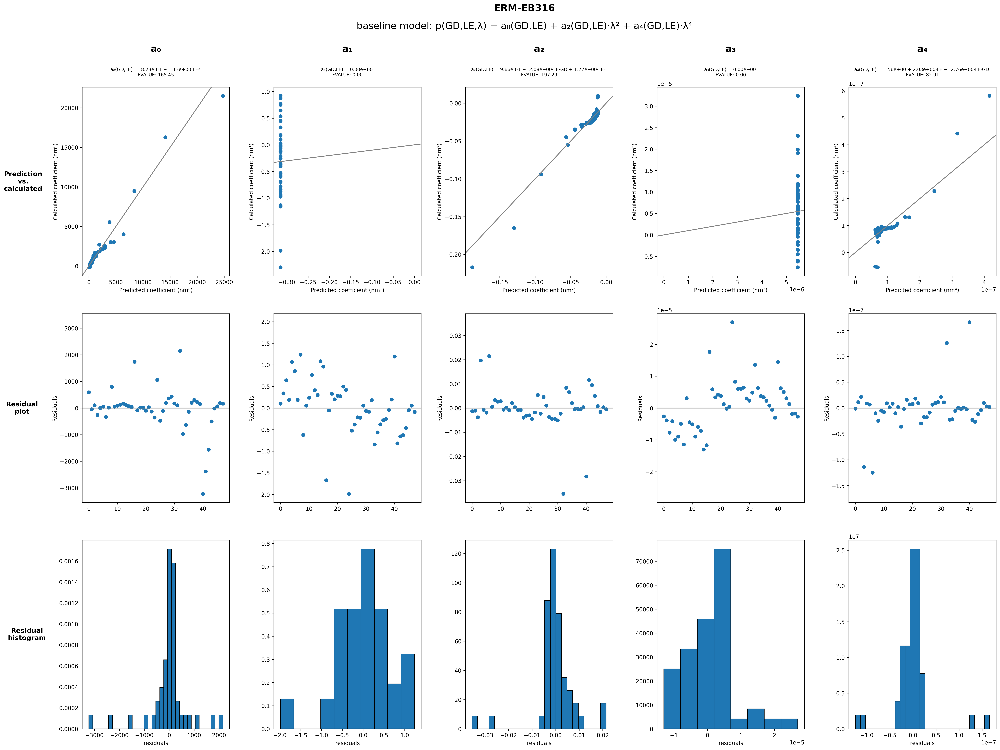

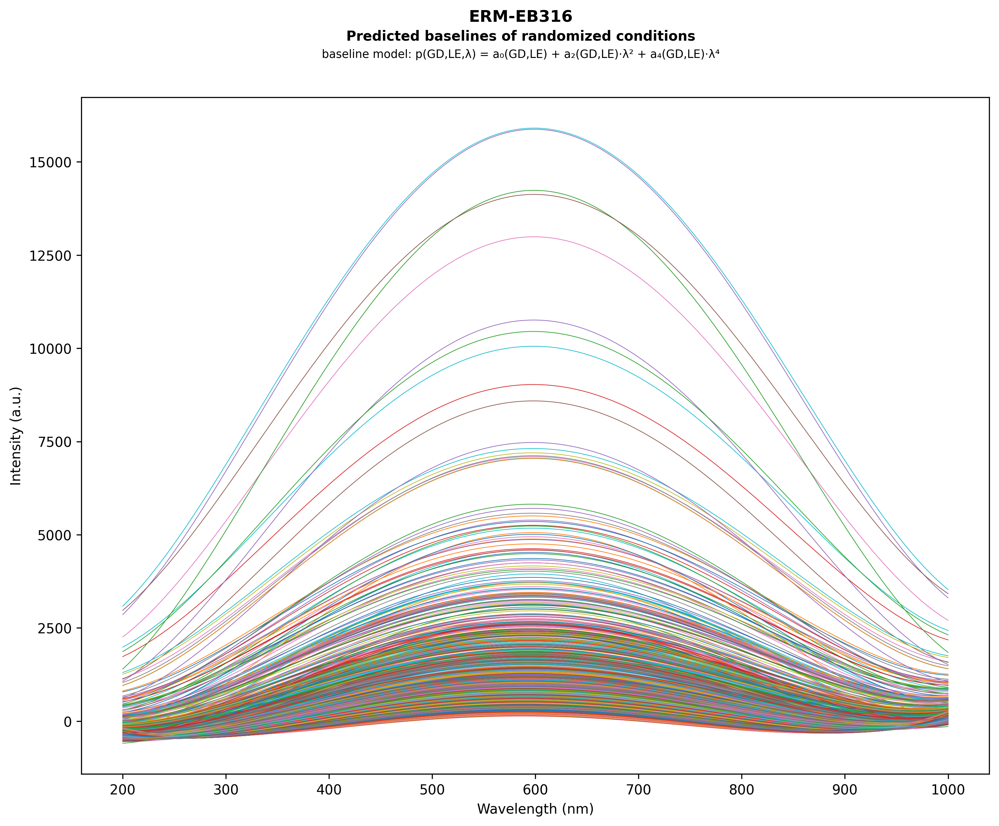

In [22]:
summary_baseline_coeff_regression, baseline_regression_settings = dataset.summarize_baseline_coefficients(deg_min=4, deg_max=4, width_wvn_detail=20, detailfactor=10, reverse=False, endpoint_weight=10000, overwrite=False)
baseline = mod.Baseline(dataset.name, summary_baseline_coeff_regression, baseline_regression_settings, median=True)
baseline_model = baseline.model.fit(transform_x=True, transform_y=True)
baseline.summary_coeff_models()
baseline.model_assessment_plot()
baseline.model_stabilty_plot(dataset.wavelength_range)

Calculate plot: 100%|██████████| 48/48 [02:11<00:00,  2.74s/it]


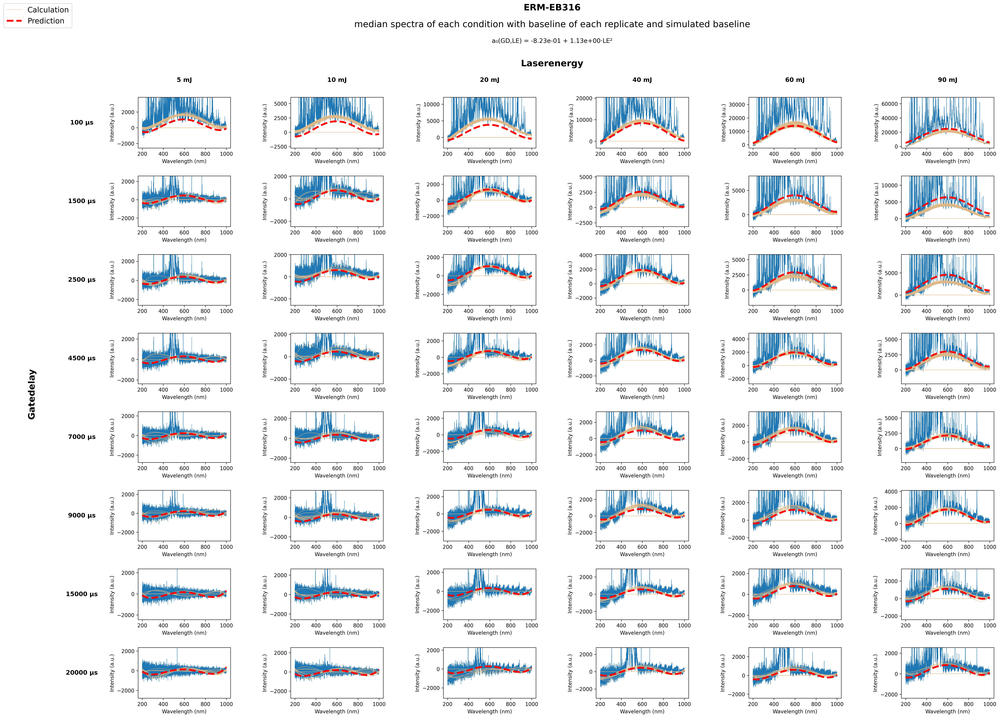

In [24]:
dataset.plot_dataset(type_list=["stability"], baseline_regression=True, baseline_model=baseline_model, deg_min=4, deg_max=4, width_wvn_detail=20, detailfactor=10, reverse=False, endpoint_weight=10000)

It can be seen that the majority of the baselines fit quite well or display an symmetric offset. However, the simulated baselines of conditions with less signal seem quite wobbly. Nevertheless, it can be expected that these shapes will not be noticeable in the final simulation since they will be covered by noise.